In [10]:
#Import all relevant libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import zscore
from ydata_profiling import ProfileReport
import sweetviz as sv
import plotly.express as px


from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn import metrics
 
## This statement allows the visuals to render within your Jupyter Notebook.
%matplotlib inline

## Loading the data
We can now load the dataset into pandas using the read_csv() function. This converts the CSV file into a Pandas dataframe.

In [11]:
#Read in the csv file and convert to a Pandas dataframe
df = pd.read_csv('final_data.csv')

df.head()

,player,team,name,position,height,age,appearance,goals,assists,yellow cards,...,goals conceded,clean sheets,minutes played,days_injured,games_injured,award,current_value,highest_value,position_encoded,winger
0,/david-de-gea/profil/spieler/59377,Manchester United,David de Gea,Goalkeeper,189.0,32.0,104,0.000000,0.000000,0.009585,...,1.217252,0.335463,9390,42,5,13,15000000,70000000,1,0
1,/jack-butland/profil/spieler/128899,Manchester United,Jack Butland,Goalkeeper,196.0,30.0,15,0.000000,0.000000,0.069018,...,1.242331,0.207055,1304,510,58,1,1500000,22000000,1,0
2,/tom-heaton/profil/spieler/34130,Manchester United,Tom Heaton,Goalkeeper,188.0,37.0,4,0.000000,0.000000,0.000000,...,0.616438,0.924658,292,697,84,4,600000,6000000,1,0
3,/lisandro-martinez/profil/spieler/480762,Manchester United,Lisandro Martínez,Defender Centre-Back,175.0,25.0,82,0.028090,0.056180,0.224719,...,0.000000,0.000000,6408,175,22,9,50000000,50000000,2,0
4,/raphael-varane/profil/spieler/164770,Manchester United,Raphaël Varane,Defender Centre-Back,191.0,30.0,63,0.017889,0.017889,0.053667,...,0.000000,0.000000,5031,238,51,21,40000000,80000000,2,0


## 1. Data Profiling:
Data profiling is a comprehensive process of examining the data available in an existing dataset and collecting statistics and information about that data. 

In [12]:
#profile = ProfileReport(df, title="Pandas Profiling Report")
#profile.to_notebook_iframe()


### Data Quality Checks and Data Cleaning:

#### 1. Reliability:

In [13]:
# The data in kaggel from the data source Transfer market

#### 2. Timeliness: 

In [14]:
#SThe data is recent from 2022 to 2023.

#### 3. Consistency: 

In [15]:
df['position'].unique()

array(['Goalkeeper', 'Defender Centre-Back', 'Defender Left-Back',
       'Defender Right-Back', 'midfield-DefensiveMidfield',
       'midfield-CentralMidfield', 'midfield-AttackingMidfield',
       'Attack-LeftWinger', 'Attack-RightWinger', 'Attack Centre-Forward',
       'midfield-RightMidfield', 'midfield-LeftMidfield',
       'Attack-SecondStriker', 'midfield', 'Attack', 'Defender'],
      dtype=object)

In [16]:
#Unify the values in the position column based on the four categories: Goalkeeper, Defender, Midfield, Attack.
df.loc[df['position'] == 'Defender Centre-Back', 'position'] = 'Defender'
df.loc[df['position'] == 'Defender Left-Back', 'position'] = 'Defender'
df.loc[df['position'] == 'Defender Right-Back', 'position'] = 'Defender'
df.loc[df['position'] == 'midfield-DefensiveMidfield', 'position'] = 'Midfielder'
df.loc[df['position'] == 'midfield-CentralMidfield', 'position'] = 'Midfielder'
df.loc[df['position'] == 'midfield-AttackingMidfield', 'position'] = 'Midfielder'
df.loc[df['position'] == 'midfield-LeftMidfield', 'position'] = 'Midfielder'
df.loc[df['position'] == 'midfield', 'position'] = 'Midfielder'
df.loc[df['position'] == 'midfield-RightMidfield', 'position'] = 'Midfielder'
df.loc[df['position'] == 'Attack Centre-Forward', 'position'] = 'Attack'
df.loc[df['position'] == 'Attack-RightWinger', 'position'] = 'Attack'
df.loc[df['position'] == 'Attack-LeftWinger', 'position'] = 'Attack'
df.loc[df['position'] == 'Attack-SecondStriker', 'position'] = 'Attack'


In [17]:
df['position'].unique()

array(['Goalkeeper', 'Defender', 'Midfielder', 'Attack'], dtype=object)

#### 4. Relevance: 

In [18]:
#The available data is consistent with the objectives of the analysis.
#There are irrelevant columns to our objectives.

In [19]:
#drop irrelevant columns
df.drop(columns= 'player', inplace = True)
df.drop(columns= 'position_encoded', inplace = True)

In [20]:
df.head()

,team,name,position,height,age,appearance,goals,assists,yellow cards,second yellow cards,red cards,goals conceded,clean sheets,minutes played,days_injured,games_injured,award,current_value,highest_value,winger
0,Manchester United,David de Gea,Goalkeeper,189.0,32.0,104,0.000000,0.000000,0.009585,0.0,0.0,1.217252,0.335463,9390,42,5,13,15000000,70000000,0
1,Manchester United,Jack Butland,Goalkeeper,196.0,30.0,15,0.000000,0.000000,0.069018,0.0,0.0,1.242331,0.207055,1304,510,58,1,1500000,22000000,0
2,Manchester United,Tom Heaton,Goalkeeper,188.0,37.0,4,0.000000,0.000000,0.000000,0.0,0.0,0.616438,0.924658,292,697,84,4,600000,6000000,0
3,Manchester United,Lisandro Martínez,Defender,175.0,25.0,82,0.028090,0.056180,0.224719,0.0,0.0,0.000000,0.000000,6408,175,22,9,50000000,50000000,0
4,Manchester United,Raphaël Varane,Defender,191.0,30.0,63,0.017889,0.017889,0.053667,0.0,0.0,0.000000,0.000000,5031,238,51,21,40000000,80000000,0


#### 5. Uniqueness: 

In [21]:
# There are no duplicate valuse

In [22]:
df.duplicated().sum()

0

#### 6. Completeness: 

In [23]:
#Display number missing values per column
df.isnull().sum()

team                   0
name                   0
position               0
height                 0
age                    0
appearance             0
goals                  0
assists                0
yellow cards           0
second yellow cards    0
red cards              0
goals conceded         0
clean sheets           0
minutes played         0
days_injured           0
games_injured          0
award                  0
current_value          0
highest_value          0
winger                 0
dtype: int64

#### 7. Check Accuracy:

In [24]:
# check columns types 
df.dtypes
# All good

team                    object
name                    object
position                object
height                 float64
age                    float64
appearance               int64
goals                  float64
assists                float64
yellow cards           float64
second yellow cards    float64
red cards              float64
goals conceded         float64
clean sheets           float64
minutes played           int64
days_injured             int64
games_injured            int64
award                    int64
current_value            int64
highest_value            int64
winger                   int64
dtype: object

In [25]:
#create new dataframe for goalkeeper info
df_goalkeeper = df[df['position'] == 'Goalkeeper'].copy()
df_goalkeeper.head()

,team,name,position,height,age,appearance,goals,assists,yellow cards,second yellow cards,red cards,goals conceded,clean sheets,minutes played,days_injured,games_injured,award,current_value,highest_value,winger
0,Manchester United,David de Gea,Goalkeeper,189.0,32.0,104,0.0,0.0,0.009585,0.0,0.0,1.217252,0.335463,9390,42,5,13,15000000,70000000,0
1,Manchester United,Jack Butland,Goalkeeper,196.0,30.0,15,0.0,0.0,0.069018,0.0,0.0,1.242331,0.207055,1304,510,58,1,1500000,22000000,0
2,Manchester United,Tom Heaton,Goalkeeper,188.0,37.0,4,0.0,0.0,0.000000,0.0,0.0,0.616438,0.924658,292,697,84,4,600000,6000000,0
32,West Ham United,Alphonse Areola,Goalkeeper,195.0,30.0,41,0.0,0.0,0.000000,0.0,0.0,0.898502,0.449251,3606,34,4,16,8000000,17500000,0
33,West Ham United,Lukasz Fabianski,Goalkeeper,190.0,38.0,75,0.0,0.0,0.040767,0.0,0.0,1.331723,0.271780,6623,554,99,4,1000000,9000000,0


In [26]:
df_goalkeeper.shape

(1229, 20)

In [40]:
#Save th df to use it in goalkeeper EDA notebook
df_goalkeeper.to_csv('goalkeeper.csv')

In [27]:
#create new dataframe without goalkeeper info
df_copy = df[df['position'] != 'Goalkeeper'].copy()
df_copy.head()

,team,name,position,height,age,appearance,goals,assists,yellow cards,second yellow cards,red cards,goals conceded,clean sheets,minutes played,days_injured,games_injured,award,current_value,highest_value,winger
3,Manchester United,Lisandro Martínez,Defender,175.0,25.0,82,0.028090,0.056180,0.224719,0.0000,0.0,0.0,0.0,6408,175,22,9,50000000,50000000,0
4,Manchester United,Raphaël Varane,Defender,191.0,30.0,63,0.017889,0.017889,0.053667,0.0000,0.0,0.0,0.0,5031,238,51,21,40000000,80000000,0
5,Manchester United,Harry Maguire,Defender,194.0,30.0,68,0.037799,0.000000,0.302394,0.0189,0.0,0.0,0.0,4762,148,27,1,25000000,70000000,0
6,Manchester United,Victor Lindelöf,Defender,187.0,28.0,70,0.000000,0.032901,0.115153,0.0000,0.0,0.0,0.0,5471,95,19,10,15000000,35000000,0
7,Manchester United,Phil Jones,Defender,185.0,31.0,8,0.000000,0.000000,0.216346,0.0000,0.0,0.0,0.0,416,932,169,7,2000000,20000000,0


In [28]:
multiply = ['goals', 'assists', 'yellow cards', 'second yellow cards', 'red cards']

#Convert the column to its previous number before scaling and save it in a new column.
for column in multiply:
    name = column + '_total'
    df_copy[name] = df_copy[column] * df['appearance']

In [29]:
df_copy.shape

(9525, 25)

In [30]:
df_copy.columns

Index(['team', 'name', 'position', 'height', 'age', 'appearance', 'goals',
       'assists', 'yellow cards', 'second yellow cards', 'red cards',
       'goals conceded', 'clean sheets', 'minutes played', 'days_injured',
       'games_injured', 'award', 'current_value', 'highest_value', 'winger',
       'goals_total', 'assists_total', 'yellow cards_total',
       'second yellow cards_total', 'red cards_total'],
      dtype='object')

In [31]:
#drop column
df_copy.drop(columns='goals conceded', inplace = True)
df_copy.drop(columns='clean sheets', inplace = True)

In [114]:
#profile2 = ProfileReport(df_copy, title="Pandas Profiling Report")
#profile2.to_notebook_iframe()


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Data visualization

In [ ]:
#Now, before removing outliers for the LR model, let's analyze our data.

**The Most Valuable Players**

In [58]:
top10_current_value = df.nlargest(10, 'current_value')

fig = px.bar(top10_current_value, x='name', y='current_value',
             title='The Most Valuable Players',
             labels={'current_value': 'Value', 'name': 'Player Name'},
             text='current_value',
             color_discrete_sequence=['#d19fe8'])
fig.show()#

In [ ]:
# All players are in the UEFA Champions League. 
# Most of the highest valued players are either attackers or midfielders
# Younger players can have a significant impact on their teams.

**Top 10 Goal Scorers**

In [56]:
df_copy['goals_total'] = df_copy['goals_total'].astype(int)

top10_goals = df_copy.nlargest(10, 'goals_total')

fig = px.bar(top10_goals, x='name', y='goals_total',
             title='Top 10 Goal Scorers',
             labels={'goals_total': 'Goals Scored', 'name': 'Player Name'},
             text='goals_total',
             color_discrete_sequence=['#d19fe8'])  
fig.show()

In [ ]:
# Most of the  players are in the UEFA Champions League. 

**Teams with the Highest Total Goals**

In [108]:
goals_sum = df_copy.groupby('team')['goals_total'].sum().reset_index()
top_10_goals = goals_sum.sort_values(by='goals_total', ascending=False).head(10)

fig = px.bar(top_10_goals, x='team', y='goals_total',
             title='Teams with the Highest Total Goals',
             labels={'goals_total': 'Goals Scored', 'team': 'Team'},
             text='goals_total',
             color_discrete_sequence=['#d19fe8'])

# Show the chart
fig.show()

In [ ]:
#Most clubs are in the UEFA Champions League.

**Top 10 Award-Winning Players**

In [117]:
fig = px.bar(df.nlargest(10, 'award'), x='name', y='award',
             title='Top 10 Award-Winning Players',
             labels={'award': 'Awards', 'name': 'Player Name'},
             text='award',
             color_discrete_sequence=['#d19fe8'])
fig.show() 


In [ ]:
# Most of the players played in the UEFA Champions League.

In [120]:
top10_goal = df_copy.nlargest(10, 'award')

In [ ]:
top_10_goals['team'].unique()

**Goals Scored vs. Appearances**

In [62]:
fig = px.scatter(df_copy, x='appearance', y='goals_total',
                 title='Goals Scored vs. Appearances',
                 labels={'appearance': 'Appearances', 'goals_total': 'Goals Scored'},
                 color_discrete_sequence=['#d19fe8'])

fig.show()

In [ ]:
#Players with more appearances tend to score more goals, as more opportunities to play lead to more chances to score.

**Average Goals Scored by Position**

In [88]:
avg_goals = df_copy.groupby('position')['goals_total'].mean().reset_index()

fig = px.bar(avg_goals, x='position', y='goals_total',
             title='Average Goals Scored by Position',
             labels={'goals_total': 'Average Goals Scored', 'position': 'Position'},
             color_discrete_sequence=['#d19fe8'])

fig.show()


In [ ]:
#Attackers have the highest scores.

**Goals vs. Assists by Position**

In [91]:
fig = px.scatter(df_copy, x='goals_total', y='assists_total',
                 size='current_value', color='position',
                 title='Goals vs. Assists by Position',                 
                 labels={'goals_total': 'Goals Scored', 'assists_total': 'Assists'},
                 )

fig.show()


In [ ]:
#Attackers have the highest scores.

**Player Value Proportion by Position**

In [100]:
fig = px.pie(df, names='position', values='current_value',
             title='Player Value Proportion by Position',
             color='position')

fig.update_layout(legend_title='Position')

fig.show()


In [ ]:
#Attack and Midfielder have the highest Value.

## Check and handle outliers

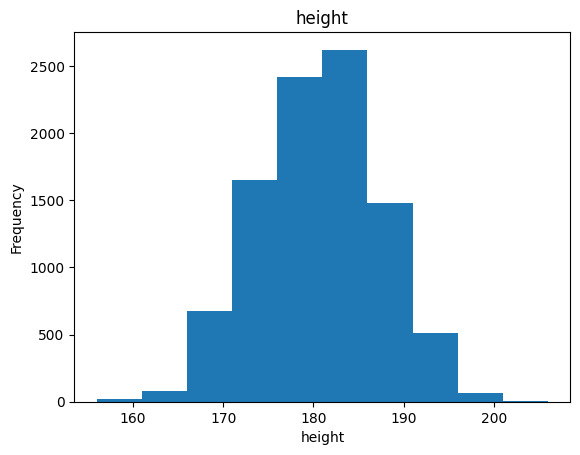

In [11]:
plt.hist(df_copy['height'])
plt.title('height')
plt.xlabel('height')
plt.ylabel('Frequency')
plt.show()

In [35]:
#df_copy = df_copy[(df_copy["height"] <= 195) & (df_copy["height"] > 166)]

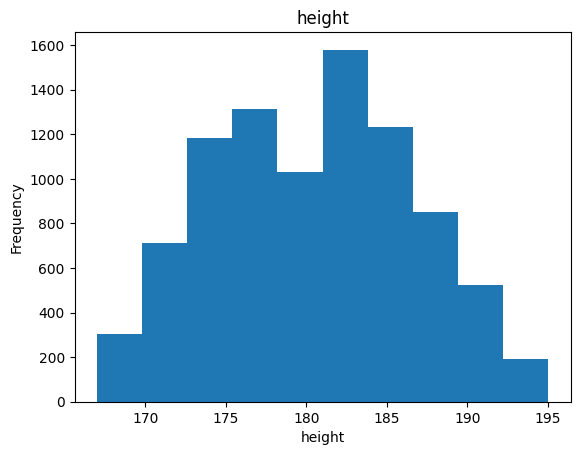

In [47]:
plt.hist(df_copy['height'])
plt.title('height')
plt.xlabel('height')
plt.ylabel('Frequency')
plt.show()


**Minutes played**

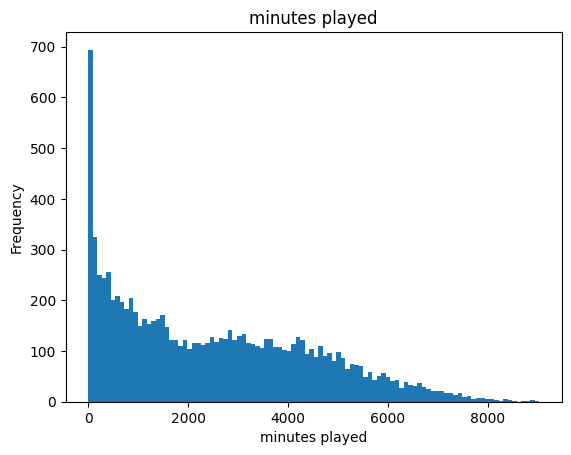

In [12]:
plt.hist(df_copy["minutes played"] ,bins=100)
plt.title('minutes played')
plt.xlabel('minutes played')
plt.ylabel('Frequency')
plt.show()

In [13]:
df_copy = df_copy[(df_copy["minutes played"] <= 8000) & (df_copy["minutes played"] > 50)]

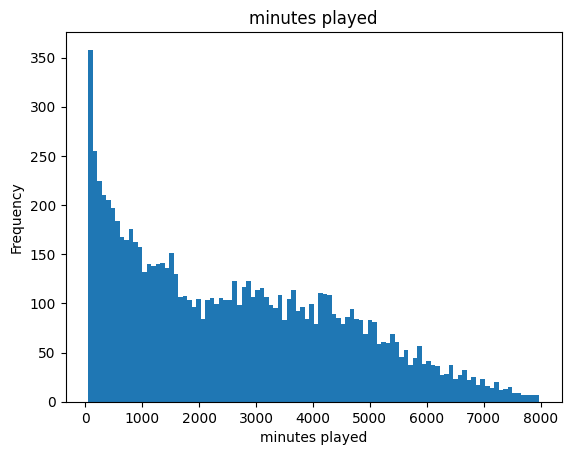

In [14]:
plt.hist(df_copy["minutes played"] ,bins=100)
plt.title('minutes played')
plt.xlabel('minutes played')
plt.ylabel('Frequency')
plt.show()

**Age**

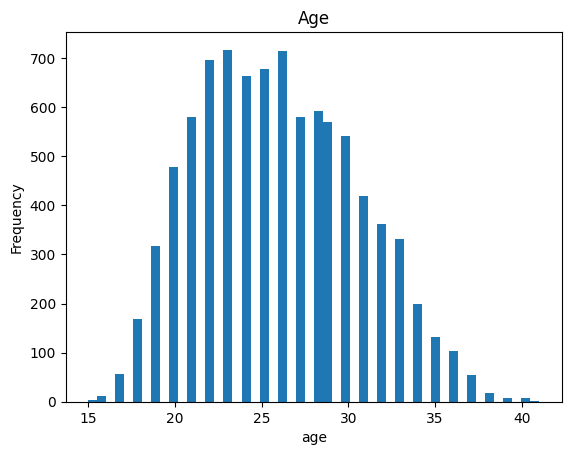

In [16]:
plt.hist(df_copy['age'], bins = 50)
plt.title('Age')
plt.xlabel('age')
plt.ylabel('Frequency')
plt.show()


In [81]:
#df_copy = df_copy[(df_copy["age"] >= 18) & (df_copy["age"] <= 35)]

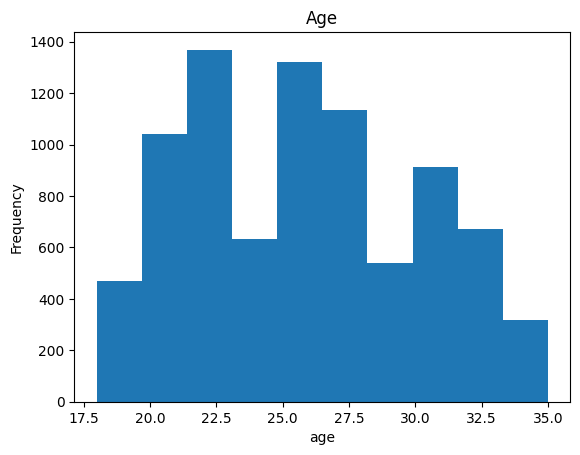

In [82]:
plt.hist(df_copy['age'])
plt.title('Age')
plt.xlabel('age')
plt.ylabel('Frequency')
plt.show()

**Appearance**

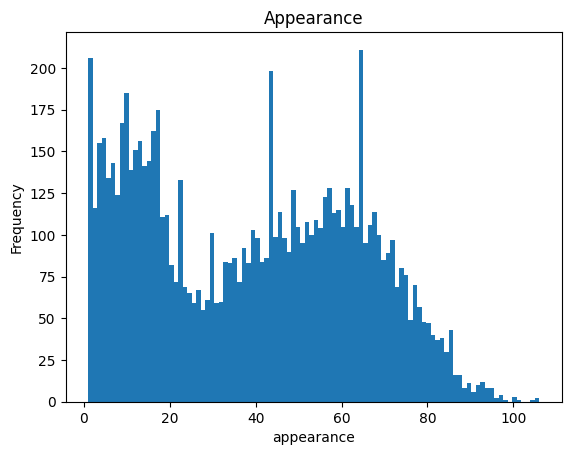

In [89]:
plt.hist(df_copy['appearance'], bins = 100)
plt.title('Appearance')
plt.xlabel('appearance')
plt.ylabel('Frequency')
plt.show()


In [18]:
df_copy = df_copy[(df_copy["appearance"] >= 0) & (df_copy["appearance"] <= 90)]

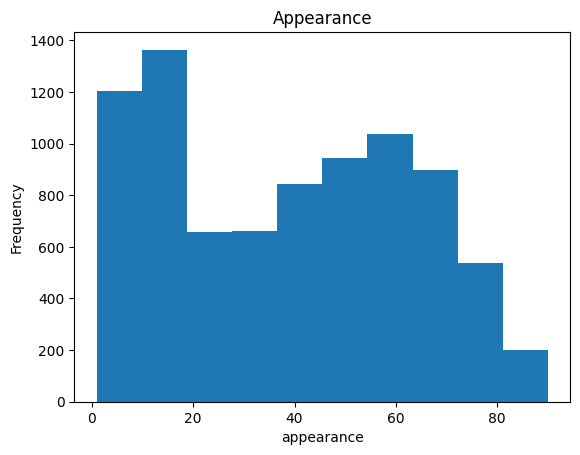

In [92]:
plt.hist(df_copy['appearance'])
plt.title('Appearance')
plt.xlabel('appearance')
plt.ylabel('Frequency')
plt.show()

**Award**

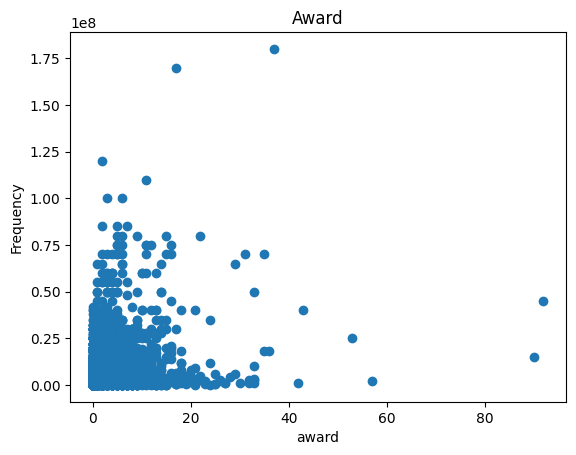

In [22]:
plt.hist(df_copy['award'], bins = 100)
plt.title('Award')
plt.xlabel('award')
plt.ylabel('Frequency')
plt.show()


In [102]:
df_copy = df_copy[df_copy["award"] <= 15]

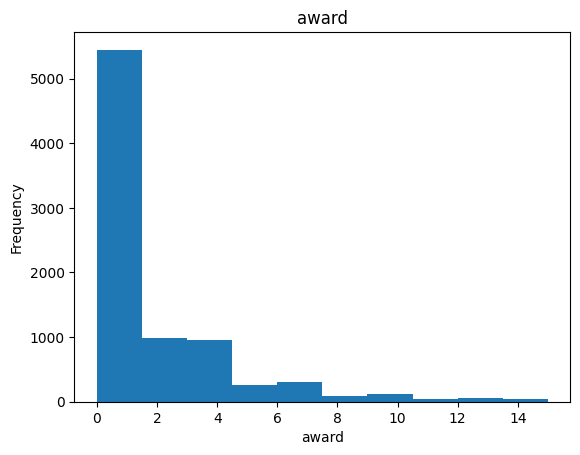

In [103]:
plt.hist(df_copy['award'])
plt.title('award')
plt.xlabel('award')
plt.ylabel('Frequency')
plt.show()


**Assists**

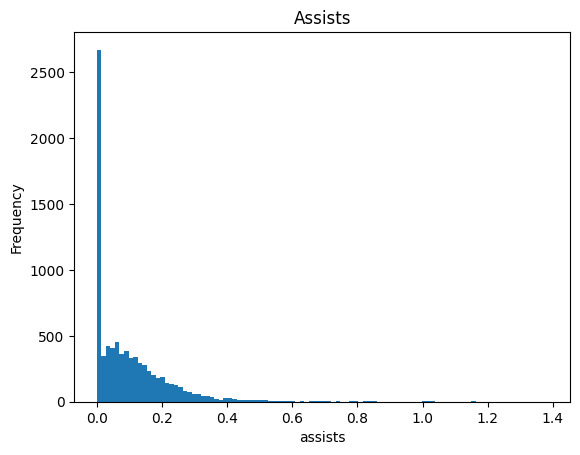

In [115]:
plt.hist(df_copy['assists'], bins = 100)
plt.title('Assists')
plt.xlabel('assists')
plt.ylabel('Frequency')
plt.show()


In [233]:
df_copy['assists'].value_counts()

assists
0.000000    3249
0.200000       6
0.100784       6
1.000000       6
0.111111       6
            ... 
0.171647       1
0.144138       1
0.242152       1
0.283514       1
0.208333       1
Name: count, Length: 5028, dtype: int64

In [120]:
df_copy = df_copy[df_copy["assists"] <= 0.5]


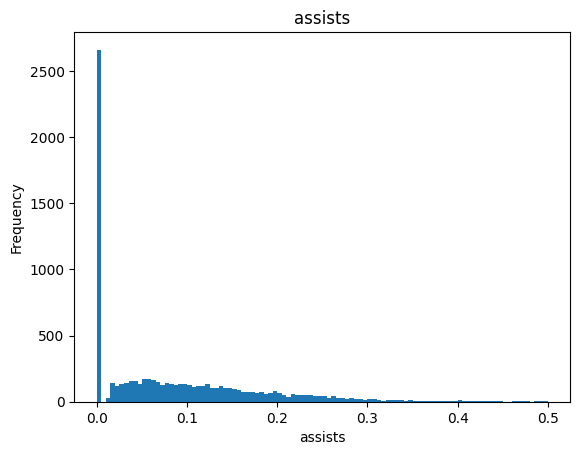

In [121]:
plt.hist(df_copy['assists'], bins= 100)
plt.title('assists')
plt.xlabel('assists')
plt.ylabel('Frequency')
plt.show()


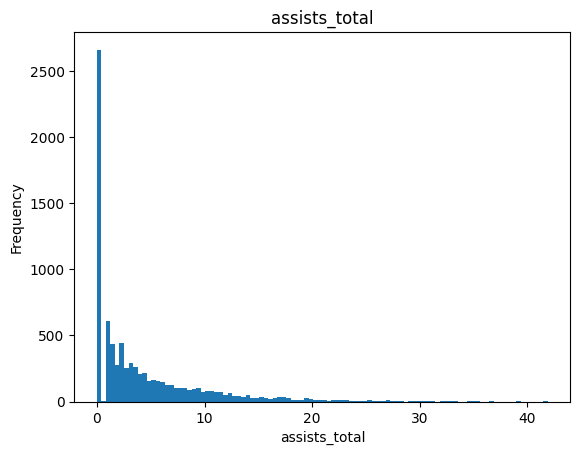

In [111]:
plt.hist(df_copy['assists_total'], bins= 100)
plt.title('assists_total')
plt.xlabel('assists_total')
plt.ylabel('Frequency')
plt.show()


In [118]:
df_copy = df_copy[df_copy["assists_total"] <20]

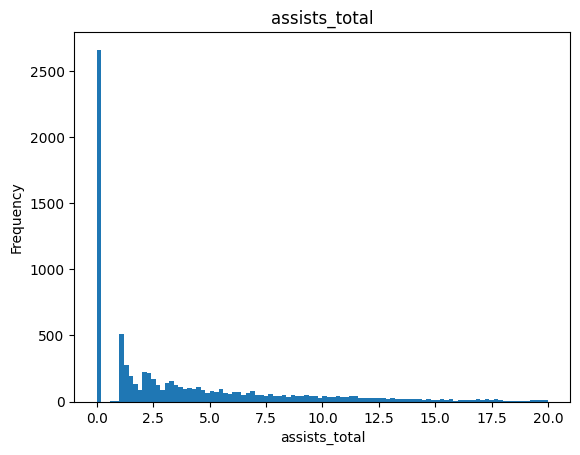

In [119]:
plt.hist(df_copy['assists_total'], bins= 100)
plt.title('assists_total')
plt.xlabel('assists_total')
plt.ylabel('Frequency')
plt.show()


In [123]:
df_copy['assists_total'].value_counts()
df_copy['assists_total'].sort_values()

10753     0.000000
3416      0.000000
3418      0.000000
3419      0.000000
3420      0.000000
           ...    
236      19.895609
6241     19.898277
5146     19.906035
1544     19.911504
6012     19.996040
Name: assists_total, Length: 8021, dtype: float64

**Yellow cards**

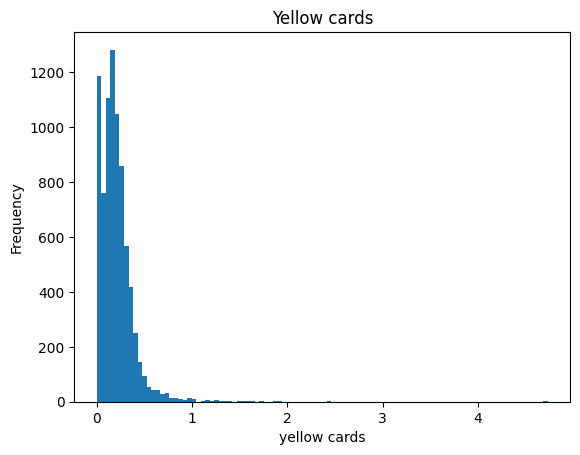

In [124]:
plt.hist(df_copy['yellow cards'], bins= 100)
plt.title('Yellow cards')
plt.xlabel('yellow cards')
plt.ylabel('Frequency')
plt.show()


In [129]:
df_copy = df_copy[df_copy["yellow cards"] <= 0.5]


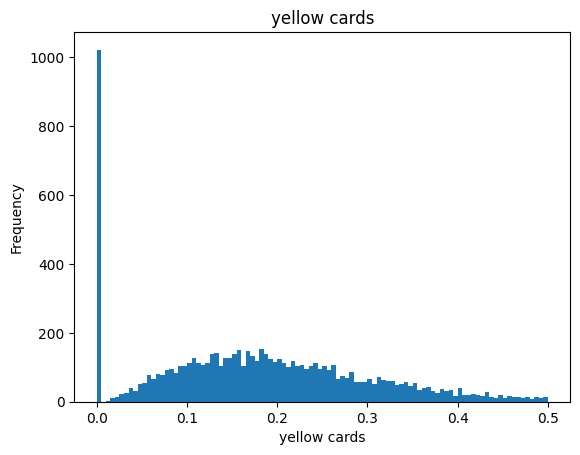

In [137]:
plt.hist(df_copy['yellow cards'], bins = 100)
plt.title('yellow cards')
plt.xlabel('yellow cards')
plt.ylabel('Frequency')
plt.show()


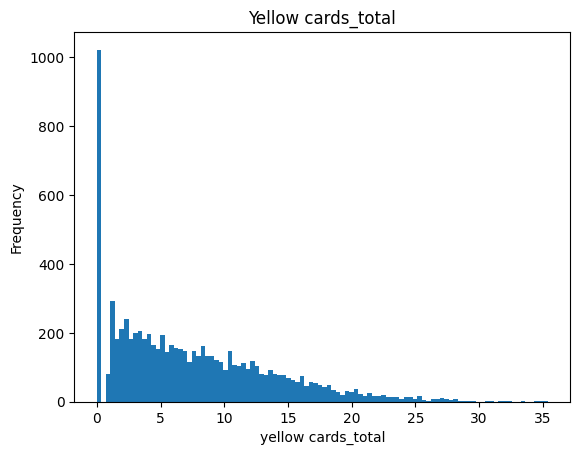

In [134]:
plt.hist(df_copy['yellow cards_total'], bins = 100)
plt.title('Yellow cards_total')
plt.xlabel('yellow cards_total')
plt.ylabel('Frequency')
plt.show()

In [138]:
df_copy = df_copy[df_copy["yellow cards_total"] <= 20]


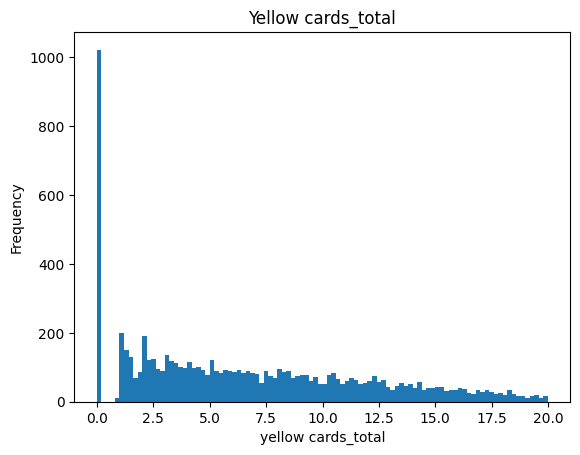

In [139]:
plt.hist(df_copy['yellow cards_total'], bins = 100)
plt.title('Yellow cards_total')
plt.xlabel('yellow cards_total')
plt.ylabel('Frequency')
plt.show()

In [131]:
df_copy.shape

(7687, 23)

**Second yellow cards**

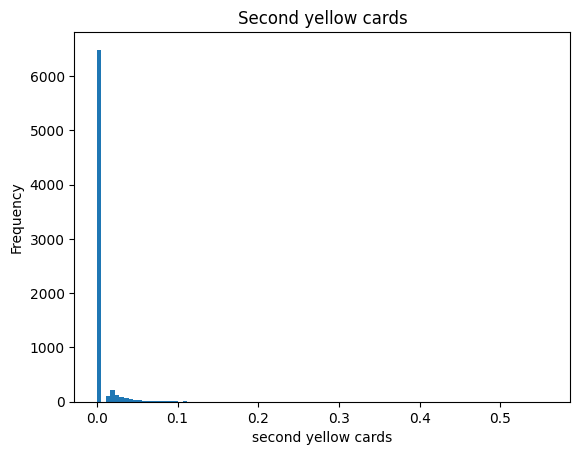

In [140]:
plt.hist(df_copy['second yellow cards'], bins = 100)
plt.title('Second yellow cards')
plt.xlabel('second yellow cards')
plt.ylabel('Frequency')
plt.show()



In [141]:
df_copy = df_copy[df_copy["second yellow cards"] <= 0.2]


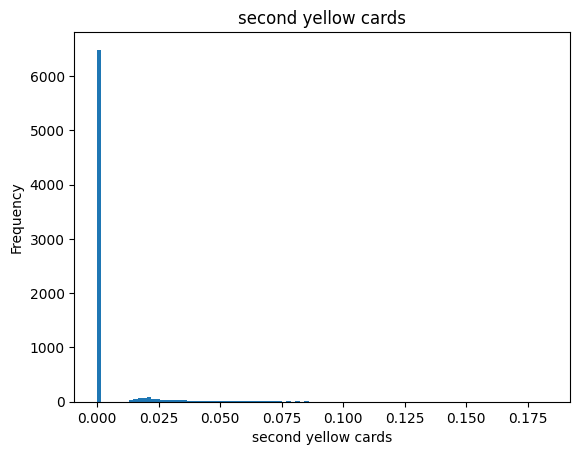

In [142]:
plt.hist(df_copy['second yellow cards'], bins = 100)
plt.title('second yellow cards')
plt.xlabel('second yellow cards')
plt.ylabel('Frequency')
plt.show()


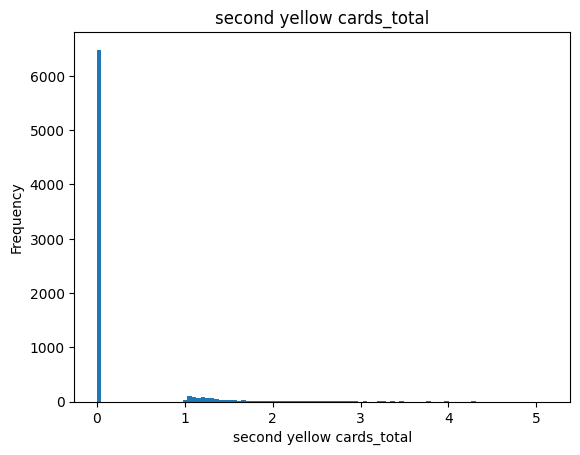

In [143]:
plt.hist(df_copy['second yellow cards_total'], bins = 100)
plt.title('second yellow cards_total')
plt.xlabel('second yellow cards_total')
plt.ylabel('Frequency')
plt.show()


In [145]:
df_copy['second yellow cards_total'].value_counts()

second yellow cards_total
0.000000    6482
1.105312       2
1.323529       2
1.181102       1
1.378958       1
            ... 
1.394448       1
1.184788       1
1.917554       1
1.246237       1
1.331190       1
Name: count, Length: 850, dtype: int64

**Red cards**

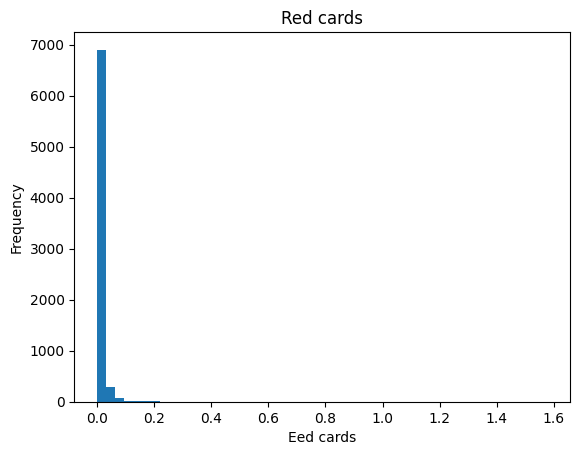

In [147]:
plt.hist(df_copy['red cards'], bins = 50)
plt.title('Red cards')
plt.xlabel('Eed cards')
plt.ylabel('Frequency')
plt.show()

In [148]:
df_copy = df_copy[df_copy["red cards"] <= 0.2]


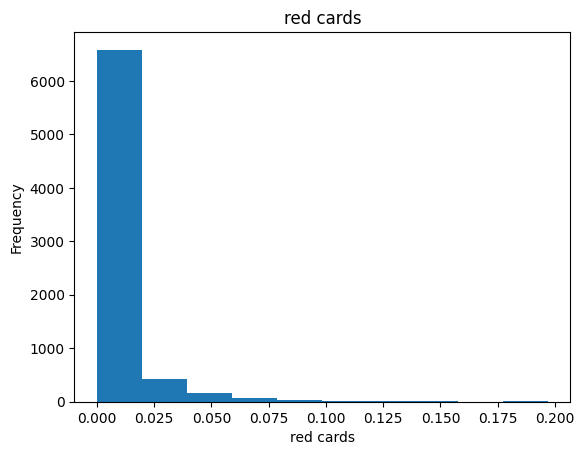

In [149]:
plt.hist(df_copy['red cards'])
plt.title('red cards')
plt.xlabel('red cards')
plt.ylabel('Frequency')
plt.show()

**Days injured**

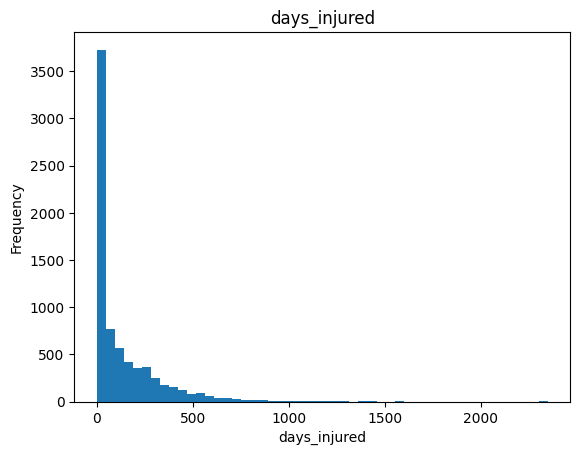

In [150]:
plt.hist(df_copy['days_injured'], bins = 50)
plt.title('days_injured')
plt.xlabel('days_injured')
plt.ylabel('Frequency')
plt.show()

In [151]:
df_copy = df_copy[df_copy["days_injured"] <= 600]


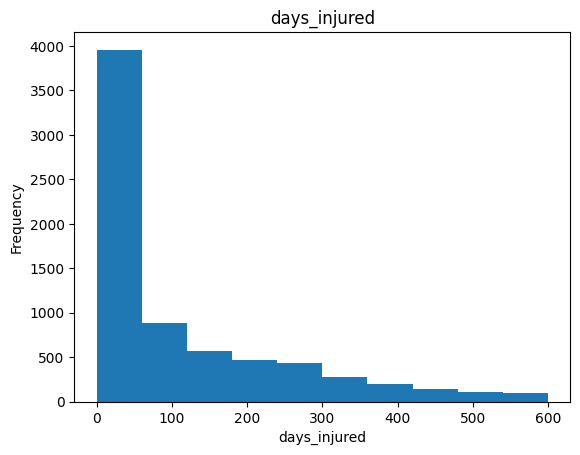

In [152]:
plt.hist(df_copy['days_injured'])
plt.title('days_injured')
plt.xlabel('days_injured')
plt.ylabel('Frequency')
plt.show()

**Games injured**

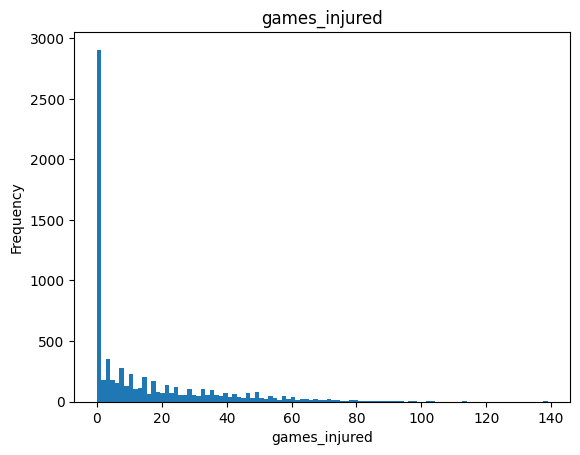

In [153]:
plt.hist(df_copy['games_injured'], bins = 100)
plt.title('games_injured')
plt.xlabel('games_injured')
plt.ylabel('Frequency')
plt.show()

In [154]:
df_copy = df_copy[df_copy["games_injured"] <= 60]

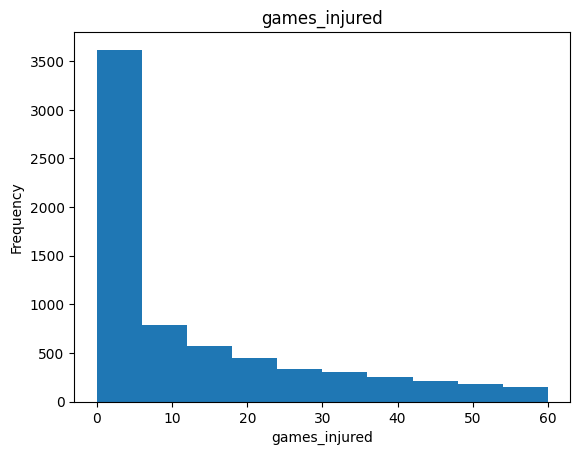

In [155]:
plt.hist(df_copy['games_injured'])
plt.title('games_injured')
plt.xlabel('games_injured')
plt.ylabel('Frequency')
plt.show()

**Goals**

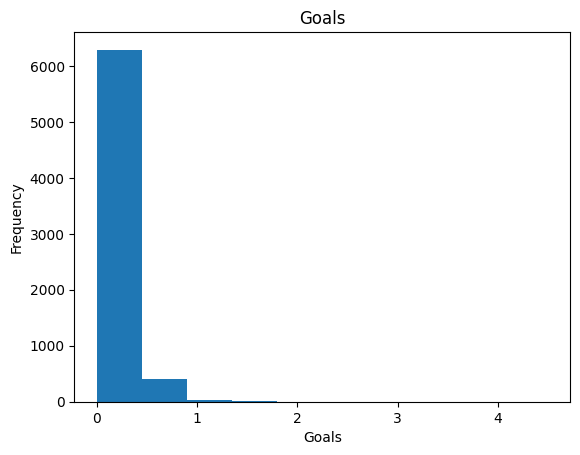

In [180]:
plt.hist(df_copy['goals'])
plt.title('Goals')
plt.xlabel('Goals')
plt.ylabel('Frequency')
plt.show()

In [183]:
df_copy = df_copy[df_copy["goals"] <= 0.6]

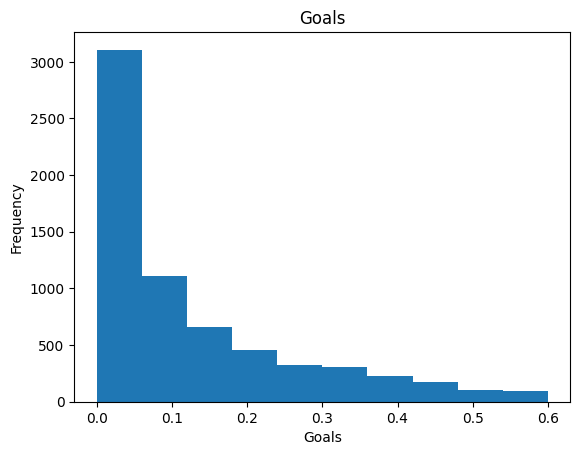

In [184]:
plt.hist(df_copy['goals'])
plt.title('Goals')
plt.xlabel('Goals')
plt.ylabel('Frequency')
plt.show()

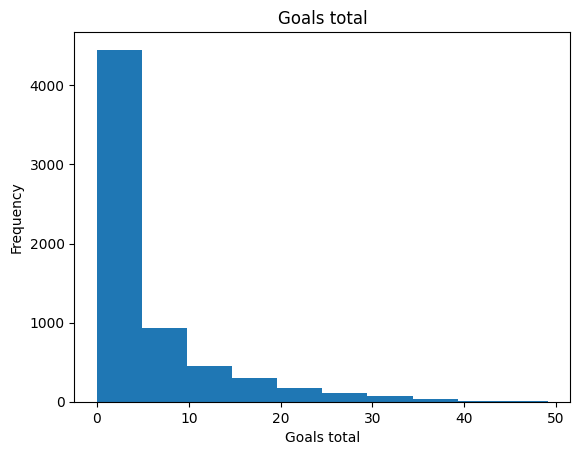

In [185]:
plt.hist(df_copy['goals_total'])
plt.title('Goals total')
plt.xlabel('Goals total')
plt.ylabel('Frequency')
plt.show()

In [186]:
df_copy = df_copy[df_copy["goals_total"] <= 30]

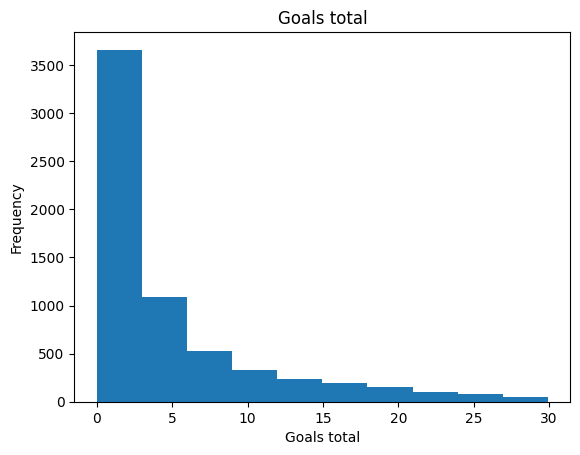

In [187]:
plt.hist(df_copy['goals_total'])
plt.title('Goals total')
plt.xlabel('Goals total')
plt.ylabel('Frequency')
plt.show()

**Current value**

In [178]:
df_copy

,team,name,position,height,age,appearance,goals,assists,yellow cards,second yellow cards,...,games_injured,award,current_value,highest_value,winger,goals_total,assists_total,yellow cards_total,second yellow cards_total,red cards_total
6,Manchester United,Victor Lindelöf,Defender,187.000000,28.0,70,0.000000,0.032901,0.115153,0.0,...,19,10,15000000,35000000,0,0.000000,2.303052,8.060684,0.0,0.000000
8,Manchester United,Teden Mengi,Defender,186.000000,21.0,34,0.000000,0.000000,0.130529,0.0,...,13,0,2000000,2000000,0,0.000000,0.000000,4.437999,0.0,0.000000
11,Manchester United,Brandon Williams,Defender,180.000000,22.0,34,0.000000,0.033507,0.335071,0.0,...,28,1,10000000,12000000,1,0.000000,1.139241,11.392405,0.0,0.000000
12,Manchester United,Diogo Dalot,Defender,183.000000,24.0,72,0.032293,0.048439,0.226050,0.0,...,49,3,35000000,35000000,1,2.325081,3.487621,16.275565,0.0,0.000000
13,Manchester United,Aaron Wan-Bissaka,Defender,183.000000,25.0,60,0.000000,0.018817,0.094083,0.0,...,20,1,22000000,40000000,1,0.000000,1.128999,5.644993,0.0,1.128999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10749,Western Sydney Wanderers,Aidan Simmons,Attack,181.240353,20.0,16,0.175953,0.087977,0.263930,0.0,...,0,0,75000,75000,1,2.815249,1.407625,4.222874,0.0,0.000000
10750,Western Sydney Wanderers,Kusini Yengi,Attack,190.000000,24.0,26,0.372671,0.186335,0.186335,0.0,...,18,0,300000,300000,0,9.689441,4.844721,4.844721,0.0,0.000000
10751,Western Sydney Wanderers,Nathanael Blair,Attack,181.240353,19.0,20,0.375000,0.000000,0.187500,0.0,...,0,0,50000,50000,0,7.500000,0.000000,3.750000,0.0,0.000000
10752,Western Sydney Wanderers,Zachary Sapsford,Attack,181.240353,20.0,17,0.312139,0.104046,0.000000,0.0,...,0,0,50000,50000,0,5.306358,1.768786,0.000000,0.0,1.768786


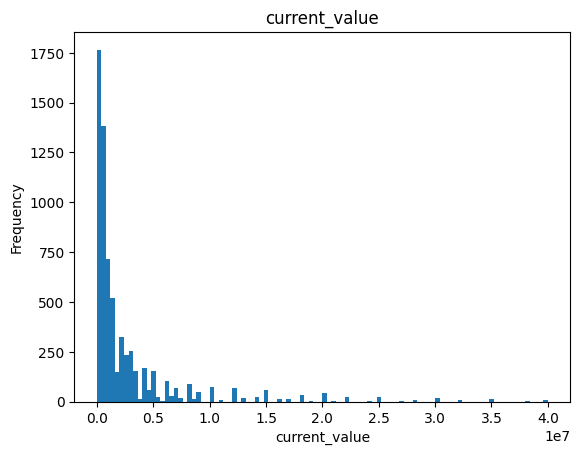

In [176]:
plt.hist(df_copy['current_value'],bins= 100)
plt.title('current_value')
plt.xlabel('current_value')
plt.ylabel('Frequency')
plt.show()

In [254]:
df_copy = df_copy[(df_copy["current_value"] <= 10000000) & (df_copy["current_value"] > 0)]



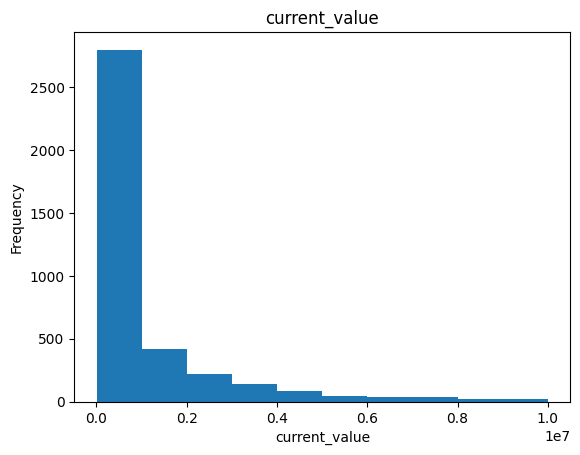

In [255]:
plt.hist(df_copy['current_value'])
plt.title('current_value')
plt.xlabel('current_value')
plt.ylabel('Frequency')
plt.show()

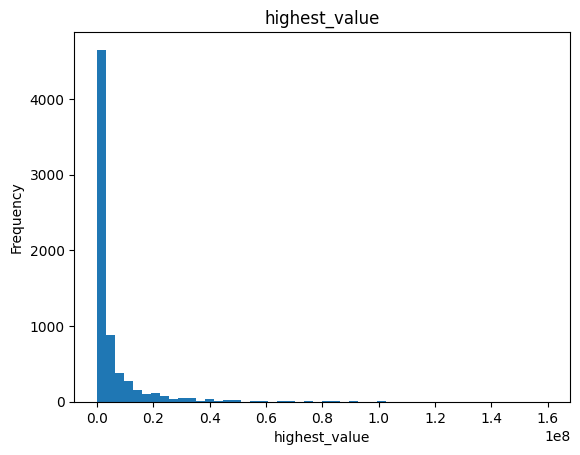

In [158]:
plt.hist(df_copy['highest_value'], bins = 50)
plt.title('highest_value')
plt.xlabel('highest_value')
plt.ylabel('Frequency')
plt.show()



In [167]:
# I think it is impossible to have 0 in "highest_value" 
df_copy = df_copy[(df_copy["highest_value"] > 10000 ) & (df_copy["highest_value"] < 40300000)]


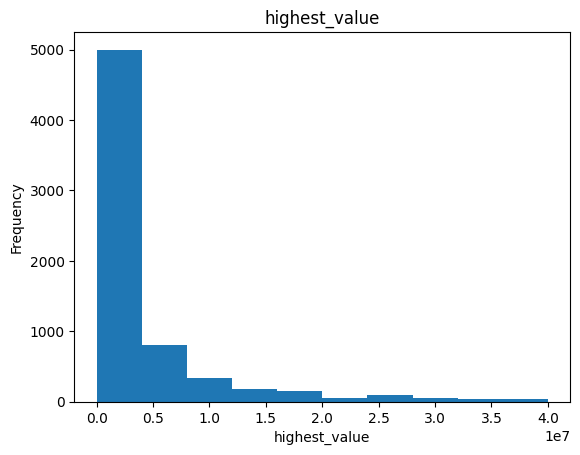

In [168]:
plt.hist(df_copy['highest_value'])
plt.title('highest_value')
plt.xlabel('highest_value')
plt.ylabel('Frequency')
plt.show()



In [171]:
df_copy.to_csv('copy.csv')

In [169]:
df_copy.shape

(6737, 23)